# Solution of Time depended Schrodinger equation for Harmonic Potential

In [1]:
import numpy as np
import matplotlib.pyplot as plt

from matplotlib import animation
from scipy import integrate
from scipy import sparse
from IPython.display import HTML
from IPython.display import display, Math, Latex
plt.rc('savefig', dpi=300)

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

First, we define the Gaussian wave packet and potential

Total Probability:  0.9999999999999992


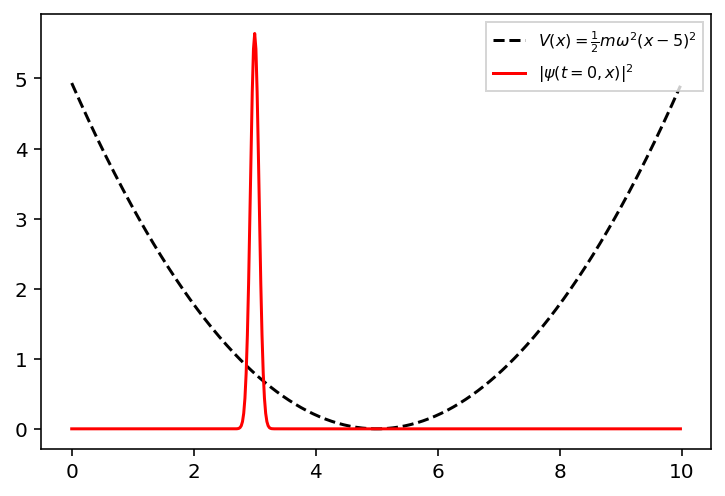

In [2]:
#discretization of the length (for solving laplace part)

dx = 0.02                 #seperation between two sections
x = np.arange(0, 10, dx)  #total number of points

# Defining the initial wave function

k_v = 0.1                 # wave vector
x_0 = 3.0                   # centre (or) peak of the initial wave packet
sigma = 0.1                 # wodth of the initial wave packet
m = 1                   # mass of the particle

psi_ini = np.sqrt((1.0 / (sigma * np.sqrt(np.pi)))) * np.exp(-1*(x - x_0)**2 / (2.0 * sigma**2)) * np.exp(1j * k_v * x)

# Defining potential

T = 1                 # Time Period
w = 2 * np.pi / T         # Omega (angular frequncy)

V = 0.5 * m * (w**2) * (x-5)**2    # Potentail is centre around x = 0

# Initial plot of Probability density and Psi_ini

plt.plot(x, V/100, "k--", label= r"$V(x) = \frac{1}{2}m\omega^2 (x-5)^2$")
plt.plot(x, np.abs(psi_ini)**2, "r", label = r"$\vert\psi(t=0,x)\vert^2$")
plt.legend(loc=1, fontsize=8, fancybox=False)
print("Total Probability: ", np.sum(np.abs(psi_ini)**2)*dx)


## Time Depended Schrodinger equation
<br>

$-\frac{\hbar^2}{2*m} \frac{\partial^2 \Psi(t, x)}{\partial x} + V(x) \Psi (t, x) = -\iota \hbar \frac{\partial \Psi (t, x)}{\partial t} $

<br>

#### Solving Laplace operator
<br>

We will solve Laplace operator using **finite difference method**. For that we will discretize the wave function in n parts: $\Psi (t, x) \rightarrow \Psi_n (t)$
<br>
\begin{align}
\frac{\partial^2}{\partial x^2} \Psi(x)
&=
\frac{1}{dx} \left[ \frac{\partial \Psi_{n+1}}{\partial x} - \frac{\partial \Psi_{n-1}}{\partial x} \right]
\\
&= 
\frac{1}{dx} \left[ \frac{\Psi_{n+1} - \Psi_{n}}{dx} - \frac{\Psi_{n} - \Psi_{n-1}}{dx} \right]
\\
&=
\frac{\Psi_{n+1} - 2 \Psi_{n} + \Psi_{n-1}}{(dx)^2} 
\\
&=
\frac{1}{(dx)^2}
\begin{pmatrix}
  -2  &  1  &  0  &  0 &  0 \\
   1  & -2  &  1  &  0 &  0 \\
   0  &  1  & -2  &  1 &  0 \\
   0  &  0  &  1  & -2 &  1 \\
   0  &  0  &  0  &  1 & -2 
\end{pmatrix}
\cdot
\begin{pmatrix}
   \Psi_1   \\
   \Psi_2   \\
   \Psi_3   \\
   \Psi_4   \\
   \Psi_5  
\end{pmatrix}
\\
&\equiv
\mathbf{D2} \cdot \mathbf{\Psi}
\end{align}


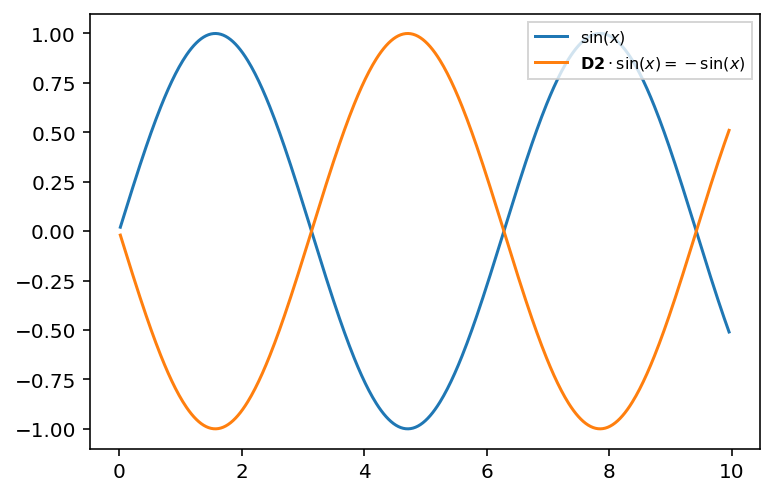

In [3]:

# D2 is a sparse metrix

D2 = sparse.diags([1, -2, 1], [-1, 0, 1], shape=(x.size, x.size)) / dx**2
D2.toarray() * dx**2

plt.plot(x[1:-1], np.sin(x)[1:-1], label=r"$\sin(x)$")
plt.plot(x[1:-1], D2.dot(np.sin(x))[1:-1], label=r"$\mathbf{D2} \cdot \sin(x) = -\sin(x)$")
plt.legend(loc=1, fontsize=8, fancybox=False)

In [4]:
# Definig the time evolution of Shrodinger equation 

#def psi(t, psi):
#    return -1j * ( -(0.5 / m) * D2.dot(psi) + V * psi)
hbar = 1
# hbar = 1.0545718176461565e-34
def psi(t, psi):
    return -1j * (- 0.5 * hbar / m * D2.dot(psi) + V / hbar * psi)


In [5]:
# Calculating the value of d(psi)/dt for every time frame to see evolution

# Defining time stamps

#dt  = 0.005     # time interval
#t_0 = 0.0         # start time
#t_f = 1.0         # end time

#t_range = np.arange(t_0, t_f, dt)

#sol = integrate.solve_ivp(psi, t_span = [t_0, t_f], y0 = psi_ini, t_eval = t_range, method = "RK23")



dt = 0.005  # time interval for snapshots
t0 = 0.0    # initial time
tf = 1.0    # final time
t_eval = np.arange(t0, tf, dt)  # recorded time shots

# Solve the Initial Value Problem
sol = integrate.solve_ivp(psi, t_span = [t0, tf], y0 = psi_ini, t_eval = t_eval, method="RK23")

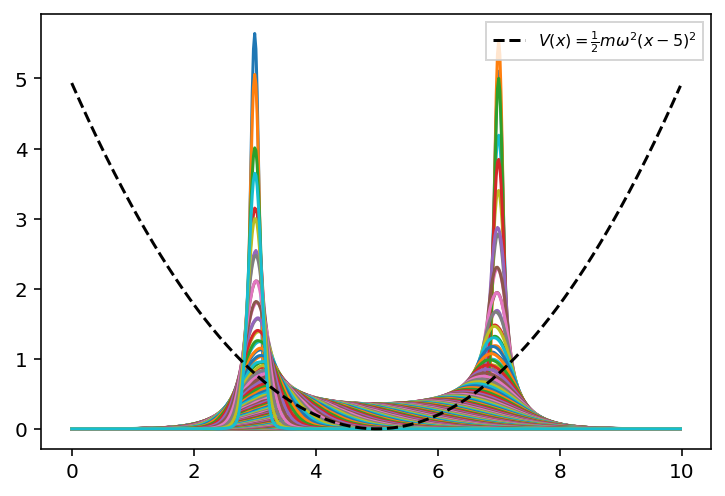

In [6]:
# Plotting the Probability density for different time

fig = plt.figure(figsize = (6, 4))

for i, t in enumerate(sol.t):
    plt.plot(x, np.abs(sol.y[:,i])**2)
    #print(np.sum(np.abs(sol.y[:,i])**2)*dx)

plt.plot(x, V/100 , "k--", label=r"$V(x) = \frac{1}{2}m\omega^2 (x-5)^2$")
plt.legend(loc=1, fontsize=8, fancybox=False)




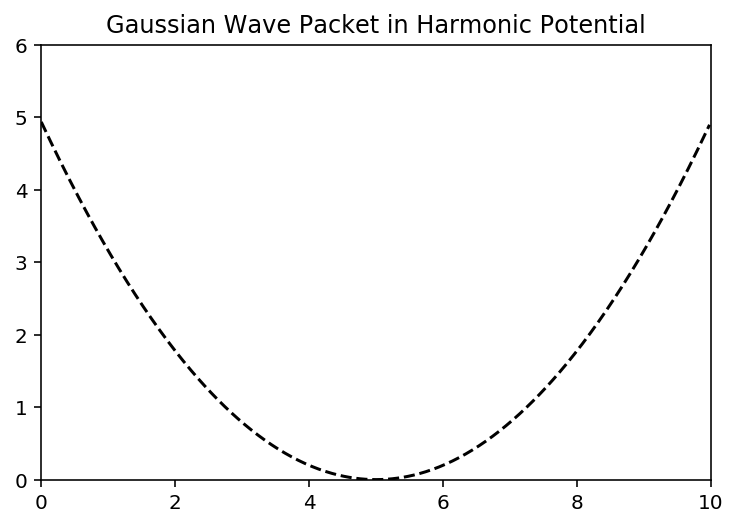

In [7]:
fig = plt.figure()
ax1 = plt.subplot(1,1,1)
ax1.set_xlim(0, 10)
ax1.set_ylim(0, 6)
title = ax1.set_title('Gaussian Wave Packet in Harmonic Potential')
line1, = ax1.plot([], [], "k--")
line2, = ax1.plot([], [])


def init():
    line1.set_data(x, V * 0.01)
    return line1,


def animate(i):
    line2.set_data(x, np.abs(sol.y[:,i])**2)
    title.set_text('Time = {0:1.3f}'.format(sol.t[i]))
    return line1,


anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=len(sol.t), interval=50, blit=True)

In [8]:

#anim.save('sho.mp4', fps=15, extra_args=['-vcodec', 'libx264'], dpi=600)
HTML(anim.to_jshtml())